# Model Workflow

In [1]:
from model.preprocess_sample import split_test_train

my_test_ratio = 0.1
myseed = 42

img_root = "c:\\nycdata\\sample_subset\\tiles\\imgs"
mask_root = "c:\\nycdata\\sample_subset\\tiles\\masks"
dataroot = "c:\\nycdata\\sample_subset\\tiles"

split_test_train(img_root, mask_root, dataroot, seed=myseed, test_ratio=my_test_ratio)

## Training

In [2]:
from model.train_model import train_unet
import os

mysize = 576
mybackbone = "resnet18"
myinputpath = os.path.join(dataroot, f"train_imgs_{myseed}")
mymaskpath = os.path.join(dataroot, f"train_masks_{myseed}")
myweightfile = f"c:\\nycdata\\sample_subset\\results\\{mybackbone}_{myseed}_weights_best.h5"
myfinalweightfile = f"c:\\nycdata\\sample_subset\\results\\{mybackbone}_{myseed}_weights_final.h5"
mylogfile = f"c:\\nycdata\\sample_subset\\results\\{mybackbone}_{myseed}_trainlog.csv"

train_unet(myinputpath, mymaskpath, mylogfile, myweightfile, myfinalweightfile, mybackbone, myseed, mysize)

Segmentation Models: using `keras` framework.
==== Load and Split Data ====
x_train:  (279, 576, 576, 3)
y_train:  (279, 576, 576, 1)
x_val:  (32, 576, 576, 3)
y_val:  (32, 576, 576, 1)
==== Preprocess Data ====
==== Augment Data ====
==== Setup Callbacks ====
==== Create Model ====
==== Compile Model ====
==== Train ====


C:\Users\jrana\Miniconda3\envs\nyc_pvnet\lib\site-packages\keras\optimizers\optimizer_v2\gradient_descent.py:111: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super().__init__(name, **kwargs)


Epoch 1/350

Epoch 1: val_loss improved from inf to 1.10390, saving model to c:\nycdata\sample_subset\results\resnet18_42_weights_best.h5
100/100 - 50s - loss: 1.0744 - iou_score: 0.0025 - val_loss: 1.1039 - val_iou_score: 0.0025 - 50s/epoch - 504ms/step
Epoch 2/350

Epoch 2: val_loss improved from 1.10390 to 1.07732, saving model to c:\nycdata\sample_subset\results\resnet18_42_weights_best.h5
100/100 - 30s - loss: 1.0312 - iou_score: 0.0067 - val_loss: 1.0773 - val_iou_score: 0.0082 - 30s/epoch - 300ms/step
Epoch 3/350

Epoch 3: val_loss did not improve from 1.07732
100/100 - 29s - loss: 0.9749 - iou_score: 0.0750 - val_loss: 1.1770 - val_iou_score: 8.6757e-04 - 29s/epoch - 287ms/step
Epoch 4/350

Epoch 4: val_loss did not improve from 1.07732
100/100 - 31s - loss: 0.8374 - iou_score: 0.2080 - val_loss: 1.5677 - val_iou_score: 1.2602e-06 - 31s/epoch - 308ms/step
Epoch 5/350

Epoch 5: val_loss did not improve from 1.07732
100/100 - 34s - loss: 0.6622 - iou_score: 0.3770 - val_loss: 1.4

KeyboardInterrupt: 

## Split

==== Load and Resize Data ====
==== Create Model ====
==== Compile Model ====
==== Load Weights ====
==== Perform Evaluation ====
3/3 [==============================] - 7s 730ms/step - loss: 0.3611 - iou_score: 0.7435 - precision: 0.9071 - recall: 0.7949 - f1-score: 0.8441
==== Save Evaluation ====
['weight file', 'loss', 'iou_score', 'precision', 'recall', 'f1-score']
['resnet18_42_weights_best.h5', 0.361084908246994, 0.7435322403907776, 0.9070585370063782, 0.7949182391166687, 0.8440828919410706]
==== Perform Predictions ====
3/3 [==============================] - 1s 225ms/step
==== Save Predictions ====


D:\Code\PyDev\Workspace\nyc_pvnet\model\eval_model.py:123: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = plt.subplots(1, cols,


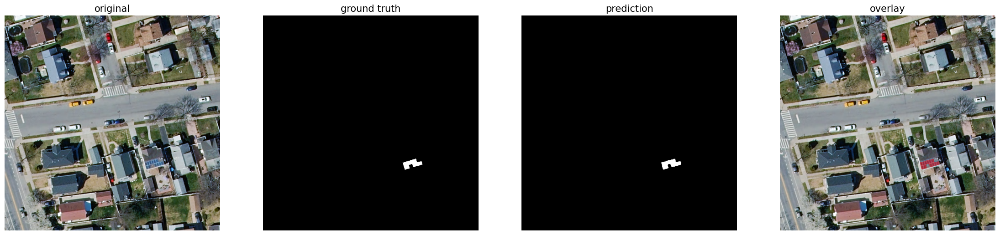

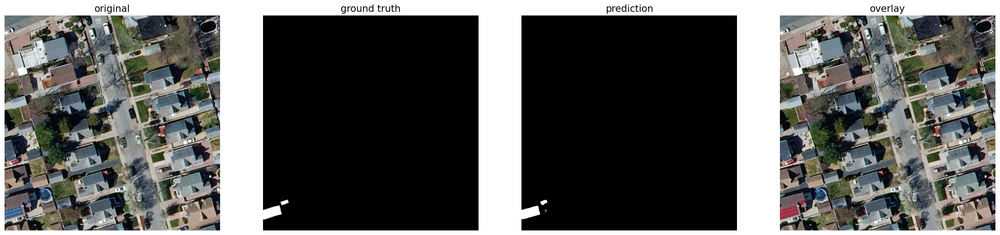

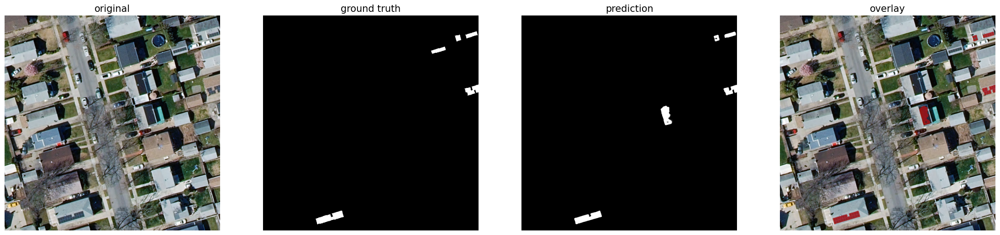

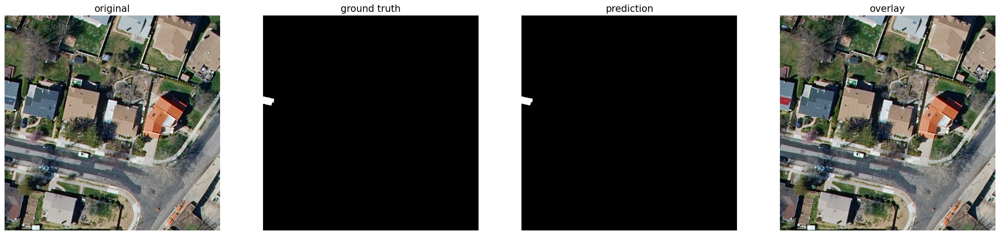

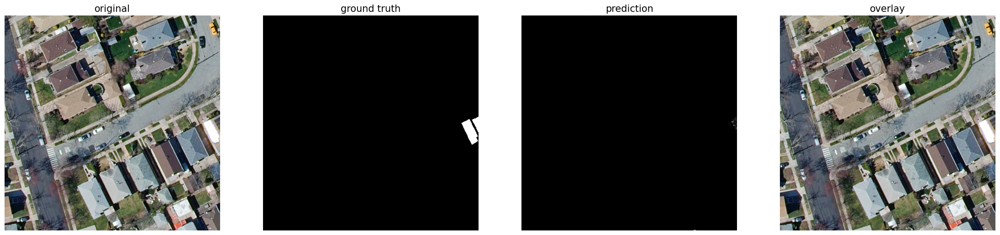

...

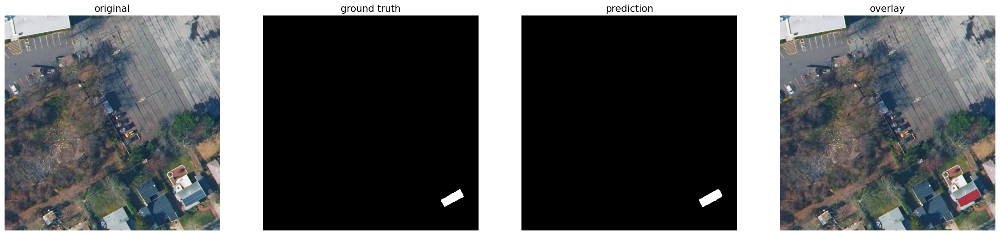

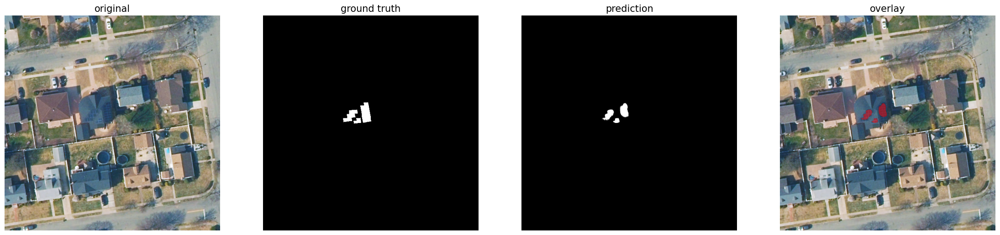

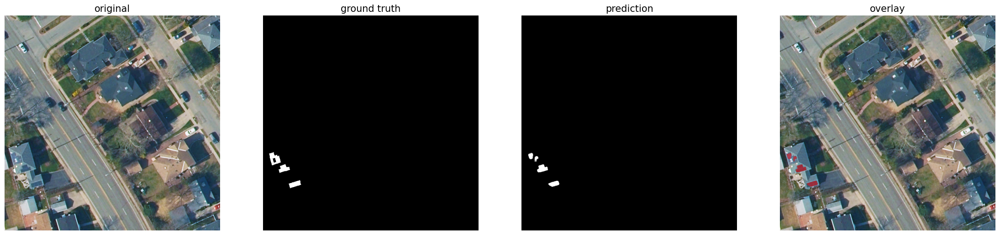

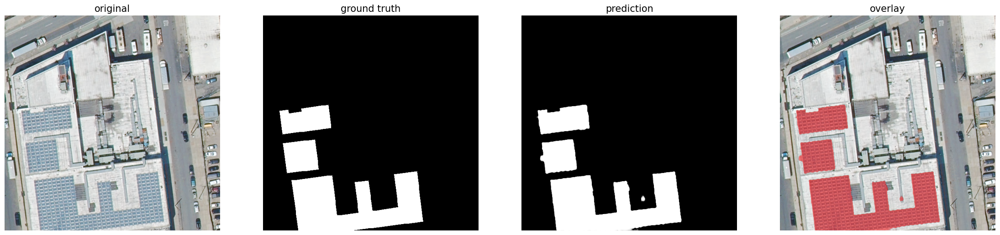

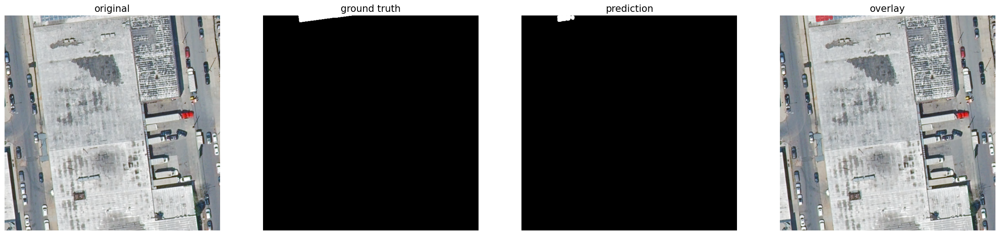

In [3]:
from model.eval_model import eval_model

mysize = 576

myimages = os.path.join(dataroot, f"test_imgs_{myseed}")
mymasks = os.path.join(dataroot, f"test_masks_{myseed}")

mypreddir = f"c:\\nycdata\\sample_subset\\results\\results_{mybackbone}_{myseed}\\pred"
myplotdir = f"c:\\nycdata\\sample_subset\\results\\results_{mybackbone}_{myseed}\\plot"
myresultfile = "c:\\nycdata\\sample_subset\\results\\performance.csv"

eval_model(myimages, mymasks, myweightfile, myresultfile, mypreddir, myplotdir, backbone=mybackbone, imsize=mysize)